# Lab №2 (Python)
Analysis of texts


Download data:

In [0]:

#dbutils.fs.rm("dbfs:/tmp/clean_lemmatized_tokenized_text/", True)

display(dbutils.fs.ls("dbfs:/FileStore/"))

path,name,size,modificationTime
dbfs:/FileStore/clean_lemmatized_tokenized_text/,clean_lemmatized_tokenized_text/,0,1734997379931
dbfs:/FileStore/tables/,tables/,0,1734997379931


In [0]:
text_location = "dbfs:/FileStore/tables/ukr_text.csv"

text_df = spark.read.format("csv") \
    .option("inferSchema", "true") \
    .option("header", "true") \
    .option("sep", ",") \
    .load(text_location)

text_df.show(10)
print(text_df.count())


+--------------------+--------------------+--------------------+
|                  Id|               Title|                Body|
+--------------------+--------------------+--------------------+
|http://k.img.com....|Кличко покликав н...|"Київ - перспекти...|
|http://k.img.com....|З'явилося відео, ...|"   З'явилося від...|
|http://k.img.com....|У центрі Києва по...|У Києві на Бессар...|
|http://k.img.com....|Нічний ураган пер...|Київ вночі 16 сер...|
|http://k.img.com....|Потоп у Києві: ст...|Уночі Київ вкотре...|
|http://k.img.com....|У Києві потрапив ...|"Колишній народни...|
|http://k.img.com....|У Києві пограбува...|"У Києві троє нев...|
|http://k.img.com....|У Києві обмежать ...|У Києві на вихідн...|
|http://k.img.com....|"У Києві ""заміну...|"На майдані Незал...|
|http://k.img.com....|У Києві посилять ...|У Києві у зв'язку...|
+--------------------+--------------------+--------------------+
only showing top 10 rows

1122


download Spacy and Ukrain module package

In [0]:
%pip install spacy
!python -m spacy download uk_core_news_sm

Note: you may need to restart the kernel using %restart_python or dbutils.library.restartPython() to use updated packages.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.9/14.9 MB 59.3 MB/s eta 0:00:00

[notice] A new release of pip is available: 23.2.1 -> 24.3.1
[notice] To update, run: pip install --upgrade pip
✔ Download and installation successful
You can now load the package via spacy.load('uk_core_news_sm')


## 1. Нормалізація та попередня обробка даних. 


1.a. Провести очищення текстових даних від стоп-слів/тегів/розмітки;


In [0]:
import spacy
import re

nlp = spacy.load("uk_core_news_sm")
stop_words = nlp.Defaults.stop_words

def is_valid_word(word: str) -> bool:
    return word not in stop_words and re.match(r"\w+", word)


1.b. Виконати токенізацію текстових елементів;

1.c. Провести лематизацію текстових елементів (наприклад можна використати бібліотеку Spacy - приклад роботи за посиланням). Зберегти результат в окремий файл.


In [0]:
from pyspark.sql.types import StringType, ArrayType
from pyspark.sql.functions import udf

def tokenize_words(text: str) -> [str]:
    lemmatized_words = [doc.lemma_ for doc in nlp(text)]

    return [word for word in lemmatized_words if is_valid_word(word)]

string_array_type = ArrayType(StringType(), False)
tokenize_words_udf = udf(tokenize_words, string_array_type)

text_tokenized_df = text_df.withColumn("TitleTokens", tokenize_words_udf(text_df["Title"]))
text_tokenized_df = text_tokenized_df.withColumn("BodyTokens", tokenize_words_udf(text_df["Body"]))

text_tokenized_df.show(10)

+--------------------+--------------------+--------------------+--------------------+--------------------+
|                  Id|               Title|                Body|         TitleTokens|          BodyTokens|
+--------------------+--------------------+--------------------+--------------------+--------------------+
|http://k.img.com....|Кличко покликав н...|"Київ - перспекти...|[кличко, покликат...|[київ, перспектив...|
|http://k.img.com....|З'явилося відео, ...|"   З'явилося від...|[з'явитися, відео...|[з'явитися, відео...|
|http://k.img.com....|У центрі Києва по...|У Києві на Бессар...|[центр, київ, вул...|[кий, бессарабськ...|
|http://k.img.com....|Нічний ураган пер...|Київ вночі 16 сер...|[нічний, ураган, ...|[київ, вночі, 16,...|
|http://k.img.com....|Потоп у Києві: ст...|Уночі Київ вкотре...|[потоп, кий, стол...|[уночі, київ, вко...|
|http://k.img.com....|У Києві потрапив ...|"Колишній народни...|[кий, потрапити, ...|[колишній, народн...|
|http://k.img.com....|У Києві пограбу

Зберегти файл

https://dbc-b21f09d6-f352.cloud.databricks.com/files/[path after FileStore/]

In [0]:
from pyspark.sql.functions import concat_ws

df = text_tokenized_df.withColumn("TitleTokens", concat_ws(",", text_tokenized_df["TitleTokens"]))
df = df.withColumn("BodyTokens", concat_ws(", ", text_tokenized_df["BodyTokens"]))
#df.display()
df.coalesce(1).write.csv("dbfs:/FileStore/clean_lemmatized_tokenized_text", header=True, mode="overwrite")
display(dbutils.fs.ls("dbfs:/FileStore/clean_lemmatized_tokenized_text/"))

path,name,size,modificationTime
dbfs:/FileStore/clean_lemmatized_tokenized_text/_committed_2184153375627024678,_committed_2184153375627024678,198,1734004730000
dbfs:/FileStore/clean_lemmatized_tokenized_text/_committed_3013742991596827181,_committed_3013742991596827181,199,1734948036000
dbfs:/FileStore/clean_lemmatized_tokenized_text/_committed_4239550916675815479,_committed_4239550916675815479,197,1734004004000
dbfs:/FileStore/clean_lemmatized_tokenized_text/_committed_8555079798563484523,_committed_8555079798563484523,198,1733949776000
dbfs:/FileStore/clean_lemmatized_tokenized_text/_committed_944587897631014727,_committed_944587897631014727,211,1733865157000
dbfs:/FileStore/clean_lemmatized_tokenized_text/_committed_vacuum5212131599550968415,_committed_vacuum5212131599550968415,224,1734948036000
dbfs:/FileStore/clean_lemmatized_tokenized_text/_started_3013742991596827181,_started_3013742991596827181,0,1734947984000
dbfs:/FileStore/clean_lemmatized_tokenized_text/_started_697654439696285533,_started_697654439696285533,0,1734005155000
dbfs:/FileStore/clean_lemmatized_tokenized_text/part-00000-tid-3013742991596827181-858a4d5c-c090-4003-91a6-c0c8a916804a-59-1-c000.csv,part-00000-tid-3013742991596827181-858a4d5c-c090-4003-91a6-c0c8a916804a-59-1-c000.csv,3378027,1734948035000


1.d. Створити Bag of Words для всіх нормалізованих слів. Зберегти результат в окремий файл.

In [0]:
from pyspark.ml.feature import CountVectorizer

vectorizer = CountVectorizer(inputCol="BodyTokens", outputCol="BagOfWords")

model = vectorizer.fit(text_tokenized_df)
bag_of_words_df = model.transform(text_tokenized_df)

bag_of_words_df.display()

Id,Title,Body,TitleTokens,BodyTokens,BagOfWords
http://k.img.com.ua/rss/ua/4013798,Кличко покликав німецьких інвесторів до Києва,"""Київ - перспективний і відкритий ринок для бізнесу та інвестицій. Про це мер Києва Віталій Кличко заявив під час виступу на Дні німецької економіки, який цьогоріч проходить у місті Аахені, інформує прес-служба в четвер, 20 вересня. Головна тема форуму - Світова торгівля в умовах глобальних змін. У ньому беруть участь близько 1000 чоловік, серед яких представники понад 50 промислово-торговельних палат Німеччини, провідних німецьких компаній, які здійснюють зовнішньоторговельну діяльність, експерти. """"Сьогодні Київ","List(кличко, покликати, німецький, інвестор, київ)","List(київ, перспективний, відкритий, ринок, бізнес, інвестиція, мер, київ, віталій, кличко, заявити, виступ, німецький, економіка, цьогоріч, проходити, місто, аахен, інформувати, прес, служба, четвер, 20, вересень, головний, тема, форум, світовий, торгівля, умова, глобальний, зміна, брати, участь, 1000, чоловік, серед, представник, понад, 50, промислово, торговельний, палата, німеччина, провідний, німецький, компанія, здійснювати, зовнішньоторговельний, діяльність, експерт, київ)","Map(vectorType -> sparse, length -> 18194, indices -> List(4, 40, 45, 56, 70, 72, 87, 100, 101, 103, 105, 118, 126, 153, 162, 166, 168, 178, 201, 221, 307, 321, 326, 329, 398, 433, 448, 505, 526, 644, 808, 948, 980, 1072, 1100, 1126, 1212, 1332, 1602, 1638, 1771, 2144, 2775, 3568, 4779, 5008, 8502, 9524, 11966), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 3.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0))"
http://k.img.com.ua/rss/ua/4001679,"З'явилося відео, як байкер почав стріляти у водія автобуса в Києві",""" З'явилося відео конфлікту між мотоциклістом і водієм автобуса в Києві, який закінчився стріляниною. Відповідний ролик в четвер, 16 серпня, був опублікований на сторінці Київ Оперативний в соцмережі Facebook. Судячи з відео, байкер зупинився перед автобусом і підійшов до місця водія, після чого той вийшов з транспорту, і почалася бійка. В результаті, водій отримав кілька поранень з травматичного пістолета, а байкер був затриманий. """"Байкер зробив 10 пострілів з пістолета Форт 17 у водія маршрутного автобуса. Пілот байка затриманий відповідно до статті 208 КПК України та поміщений в ізолятор тимчасового утримання. Відкрито кримінальне провадження за статтею 296 КК України (хуліганство)""""","List(з'явитися, відео, байкер, почати, стріляти, водій, автобус, кий)","List(з'явитися, відео, конфлікт, мотоцикліст, водій, автобус, кий, закінчитися, стрілянина, відповідний, ролик, четвер, 16, серпень, опублікований, сторінка, київ, оперативний, соцмережа, facebook, судячи, відео, байкер, зупинитися, автобус, підійти, місце, водій, вийти, транспорт, початися, бійка, результат, водій, отримати, поранення, травматичний, пістолет, байкер, затриманий, байкер, зробити, 10, постріл, пістолет, форт, 17, водій, маршрутний, автобус, пілот, байка, затриманий, відповідно, стаття, 208, кпк, україна, поміщений, ізолятор, тимчасовий, утримання, відкрити, кримінальний, провадження, стаття, 296, кк, україна, хуліганство)","Map(vectorType -> sparse, length -> 18194, indices -> List(0, 12, 26, 44, 54, 62, 63, 86, 104, 108, 118, 141, 162, 183, 186, 248, 251, 267, 357, 520, 571, 688, 702, 725, 754, 1051, 1227, 1309, 1514, 1738, 1742, 1856, 1908, 1983, 2173, 2262, 2291, 2379, 2400, 2835, 2951, 3366, 3511, 4663, 4905, 5672, 5852, 6076, 6129, 6280, 6696, 7694, 9093, 9604, 12472, 16170, 16362, 17422), values -> List(2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 4.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 3.0, 1.0, 1.0, 1.0, 2.0, 1.0, 3.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0))"
http://k.img.co

1.e. Порахувати метрику TF-IDF для 10 слів, що найчастіше зустрічаються в корпусі документів;


In [0]:
from pyspark.ml.feature import IDF

idf = IDF(inputCol="BagOfWords", outputCol="IDF")
idf_model = idf.fit(bag_of_words_df)
tf_idf_df = idf_model.transform(bag_of_words_df)

tf_idf_df.display()

Id,Title,Body,TitleTokens,BodyTokens,BagOfWords,IDF
http://k.img.com.ua/rss/ua/4013798,Кличко покликав німецьких інвесторів до Києва,"""Київ - перспективний і відкритий ринок для бізнесу та інвестицій. Про це мер Києва Віталій Кличко заявив під час виступу на Дні німецької економіки, який цьогоріч проходить у місті Аахені, інформує прес-служба в четвер, 20 вересня. Головна тема форуму - Світова торгівля в умовах глобальних змін. У ньому беруть участь близько 1000 чоловік, серед яких представники понад 50 промислово-торговельних палат Німеччини, провідних німецьких компаній, які здійснюють зовнішньоторговельну діяльність, експерти. """"Сьогодні Київ","List(кличко, покликати, німецький, інвестор, київ)","List(київ, перспективний, відкритий, ринок, бізнес, інвестиція, мер, київ, віталій, кличко, заявити, виступ, німецький, економіка, цьогоріч, проходити, місто, аахен, інформувати, прес, служба, четвер, 20, вересень, головний, тема, форум, світовий, торгівля, умова, глобальний, зміна, брати, участь, 1000, чоловік, серед, представник, понад, 50, промислово, торговельний, палата, німеччина, провідний, німецький, компанія, здійснювати, зовнішньоторговельний, діяльність, експерт, київ)","Map(vectorType -> sparse, length -> 18194, indices -> List(4, 40, 45, 56, 70, 72, 87, 100, 101, 103, 105, 118, 126, 153, 162, 166, 168, 178, 201, 221, 307, 321, 326, 329, 398, 433, 448, 505, 526, 644, 808, 948, 980, 1072, 1100, 1126, 1212, 1332, 1602, 1638, 1771, 2144, 2775, 3568, 4779, 5008, 8502, 9524, 11966), values -> List(1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 3.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 2.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0))","Map(vectorType -> sparse, length -> 18194, indices -> List(4, 40, 45, 56, 70, 72, 87, 100, 101, 103, 105, 118, 126, 153, 162, 166, 168, 178, 201, 221, 307, 321, 326, 329, 398, 433, 448, 505, 526, 644, 808, 948, 980, 1072, 1100, 1126, 1212, 1332, 1602, 1638, 1771, 2144, 2775, 3568, 4779, 5008, 8502, 9524, 11966), values -> List(1.8879605176881813, 2.5694116584849356, 2.6417323200645617, 2.350930120276537, 2.761079077697128, 3.656463124751969, 2.604918346941845, 2.7752637126890844, 2.6930256144521123, 2.849371684842806, 2.61703970747419, 8.889947832576071, 2.654311102271422, 2.9462215108327237, 2.819066335347477, 2.963315944192024, 3.0534670411863214, 3.3601973086087966, 3.0534670411863214, 3.2170964649681233, 3.3861727950120573, 3.3348795006245067, 3.7656624167169612, 7.116046103877434, 3.440240016282333, 3.558023051938717, 3.497398430122282, 3.656463124751969, 3.622561573076288, 3.9792365170150203, 3.9792365170150203, 4.0280266811844525, 4.079319975572003, 4.190545610682227, 4.384701625123184, 4.458809597276907, 4.538852304950443, 4.315708753636233, 4.944317413058608, 4.826534377402224, 4.538852304950443, 4.826534377402224, 4.944317413058608, 5.231999485510388, 5.925146666070334, 5.637464593618552, 5.925146666070334, 6.3306117741784975, 6.3306117741784975))"
http://k.img.com.ua/rss/ua/4001679,"З'явилося відео, як байкер почав стріляти у водія автобуса в Києві",""" З'явилося відео конфлікту між мотоциклістом і водієм автобуса в Києві, який закінчився стріляниною. Відповідний ролик в четвер, 16 серпня, був опублікований на сторінці Київ Оперативний в соцмережі Facebook. Судячи з відео, байкер зупинився перед автобусом і підійшов до місця водія, після чого той вийшов з транспорту, і почалася бійка. В результаті, водій отримав кілька поранень з травматичного пістолета, а байкер був затриманий. """"Байкер зробив 10 пострілів з пістолета Форт 17 у водія маршрутного автобуса. Пілот байка затриманий відповідно до статті 208 КПК України та поміщений в ізолятор тимчасового утримання. Відкрито кримінальне провадження за статтею 296 КК України (хуліганство)""""","List(з'явитися, відео, байкер, почати, стріляти, водій, автобус, кий)","List(з'явитися, відео, конфлікт, мотоцикліст, водій, автобус, ки

In [0]:
idf_values = idf_model.idf.toArray()
vocabulary = model.vocabulary
idf_vocabulary = zip(vocabulary, idf_values)

for word, idf_value in list(idf_vocabulary)[:10]:
    print(f"{word}: {idf_value}")


україна: 1.2807557669289609
рок: 1.4669308930389056
свій: 1.3712697744697926
1: 2.2963711360261025
компанія: 1.8879605176881813
новий: 1.7662635827106616
світ: 1.8197522676616478
стати: 1.776734882577957
0: 3.1736113530283845
2019: 1.936162619506059


1.f. Порахувати косинусну подібність між полями датасету title та body за 

In [0]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics.pairwise import cosine_similarity
import pandas as pd

def calculate_cosine_similarity(text1: [str], text2: [str]) -> float:
  data = [' '.join(text1), ' '.join(text2)]
    
  vectorizer = CountVectorizer()
  vectorizer.fit(data)
  vectors = vectorizer.transform(data).toarray()

  cos_similarity = cosine_similarity(vectors)
  return cos_similarity[0][1]



In [0]:
text_tokenized_df_pd = text_tokenized_df.select("TitleTokens", "BodyTokens").toPandas()

text_tokenized_df_pd["CosineSimilarity"] = text_tokenized_df_pd.apply(
    lambda row: calculate_cosine_similarity(row["TitleTokens"], row["BodyTokens"]),
    axis=1
)

text_cos_sim_df = spark.createDataFrame(text_tokenized_df_pd)
text_cos_sim_df.display()

TitleTokens,BodyTokens,CosineSimilarity
"List(кличко, покликати, німецький, інвестор, київ)","List(київ, перспективний, відкритий, ринок, бізнес, інвестиція, мер, київ, віталій, кличко, заявити, виступ, німецький, економіка, цьогоріч, проходити, місто, аахен, інформувати, прес, служба, четвер, 20, вересень, головний, тема, форум, світовий, торгівля, умова, глобальний, зміна, брати, участь, 1000, чоловік, серед, представник, понад, 50, промислово, торговельний, палата, німеччина, провідний, німецький, компанія, здійснювати, зовнішньоторговельний, діяльність, експерт, київ)",0.34641016151377546
"List(з'явитися, відео, байкер, почати, стріляти, водій, автобус, кий)","List(з'явитися, відео, конфлікт, мотоцикліст, водій, автобус, кий, закінчитися, стрілянина, відповідний, ролик, четвер, 16, серпень, опублікований, сторінка, київ, оперативний, соцмережа, facebook, судячи, відео, байкер, зупинитися, автобус, підійти, місце, водій, вийти, транспорт, початися, бійка, результат, водій, отримати, поранення, травматичний, пістолет, байкер, затриманий, байкер, зробити, 10, постріл, пістолет, форт, 17, водій, маршрутний, автобус, пілот, байка, затриманий, відповідно, стаття, 208, кпк, україна, поміщений, ізолятор, тимчасовий, утримання, відкрити, кримінальний, провадження, стаття, 296, кк, україна, хуліганство)",0.4853626716970755
"List(центр, київ, вулиця, померти, чоловік)","List(кий, бессарабський, площа, вранці, четвер, 16, серпень, вулиця, померти, чоловік, повідомляти, информатор, слово, очевидець, супермаркет, підійти, двоє, чоловік, одному, стати, зле, лягти, сходинка, почати, задихатися, прибулий, місце, медик, виявитися, безсилі, констатувати, смерть, попередній, дані, причина, загибель, чоловік, стати, передозування, наркотик, Раніше, дніпро, територія, слобожанський, проспект, знайти, труп, повідомлялося, харко, університетський, вулиця, померти, жінка)",0.3882901373576604
"List(нічний, ураган, перетворити, хрещатик, смітник)","List(київ, вночі, 16, серпень, пережити, найсильніший, гроза, зливовий, дощ, блискавка, град, порив, вітер, настільки, сильний, зламати, хрещатик, дерево, рекламний, щит, вивіска, Повністю, знести, залишок, полотнище, прикриватися, згорілий, будинок, профспілка, дивитися, фото, нічний, ураган, перетворити, хрещатик, смітник, потік, дощ, вночі, повністю, залити, асфальт, наскидали, гора, сміття, комунальник, розпочати, прибирання, хрещатик, вручну, стоячи, гомілковий, кісточка, вода, рух, автомобіль, вулиця, відкрити, нагадати, ніч, четвер, 16, серпень, столиця, накрити, ураган, град)",0.3835706411883073
"List(потоп, кий, столиця, накрити, ураган, град)","List(уночі, київ, вкотре, накрити, негода, найсильніший, дощ, підтопити, магазин, перехід, хрещатик, перетворитися, річка, потужний, вітер, повалити, дерево, машина, трамвайний, колія, маршрут, перекритий, знімок, відео, нічний, армагедона, публікувати, житель, місто, судячи, пост, соцмережа, сильно, постраждав, поділ, татарка, дарниця, шулявка, хрещатик, град, киев, публикация, от, андрей, 15, авг, 2018, 5:57, pdt, синоптик, наталія, діденко, свій, сторінка, facebook, опублікувати, знімок, потужний, атмосферний, фронт, накрити, столиця, наприкінці, липень, київ, накрити, потужний, злива, випасти, тримісячний, норма, опади, новина, корреспондент.net, telegram, підписуйтесь, канал, https://t.me/korrespondentnet)",0.2051524849655546
"List(кий, потрапити, дтп, екс, нардеп, мірошниченко)","List(колишній, народний, депутат, партія, свобода, ігор, мірошниченко, потрапити, аварія, проспект, перемога, кий, повідомляти, 112, україна, зазначатися, зіткнутися, автомобіль, honda, bmw, мірошниченко, водій, honda, стверджувати, рухатися, смуга, швидкість, 90, км, год, підрізати, автомобіль, проїхати, повз, врізатися, bmw, кермом, їхати, колишній, народний, депутат, їхати, швидкісний, частина, червоний, машина, поворотник, наліво)",0.20412414523193154
"List(кий, пограбувати, ювелірний, магазин, застрелити, охоронець)","List(кий, троє, невідомий, пограбувати, ювелірний, 

## 2. Інтелектуальний аналіз текстів з використанням LLM моделей:

2.с. Порахувати косинусну подібність між полями датасету title та body за допомого LLM моделі.


In [0]:
import torch
from transformers import AutoTokenizer, AutoModel
from sklearn.metrics.pairwise import cosine_similarity
import numpy as np
from pyspark.sql.types import ArrayType, DoubleType
from pyspark.sql.functions import udf, col

model_name = "bert-base-multilingual-cased"
tokenizer = AutoTokenizer.from_pretrained(model_name)
model = AutoModel.from_pretrained(model_name)

def get_vector_embedding_udf(text):
    inputs = tokenizer(text, return_tensors="pt", truncation=True, padding=True, max_length=512)
    with torch.no_grad():
        outputs = model(**inputs)
    embedding = outputs.last_hidden_state.mean(dim=1).squeeze().numpy()
    return np.array(embedding).tolist()

vector_embedding_udf = udf(get_vector_embedding_udf, ArrayType(DoubleType()))

text_llm_cos_sim_df = text_df.withColumn("TitleVector", vector_embedding_udf(col("Title")))
text_llm_cos_sim_df = text_llm_cos_sim_df.withColumn("BodyVector", vector_embedding_udf(col("Body")))

def cosine_similarity_func(vector1, vector2):
    return float(cosine_similarity([vector1], [vector2])[0][0])

cosine_similarity_udf = udf(cosine_similarity_func, DoubleType())
text_llm_cos_sim_df = text_llm_cos_sim_df.withColumn("CosineSimilarityLLM", cosine_similarity_udf(col("TitleVector"), col("BodyVector")))

text_llm_cos_sim_df.display()


tokenizer_config.json:   0%|          | 0.00/49.0 [00:00<?, ?B/s]

/databricks/python/lib/python3.11/site-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


config.json:   0%|          | 0.00/625 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/996k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.96M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/714M [00:00<?, ?B/s]

Id Title Body TitleVector BodyVector CosineSimilarityLLM http://k.img.com.ua/rss/ua/4013798 Кличко покликав німецьких інвесторів до Києва "Київ - перспективний і відкритий ринок для бізнесу та інвестицій. Про це мер Києва Віталій Кличко заявив під час виступу на Дні німецької економіки, який цьогоріч проходить у місті Аахені, інформує прес-служба в четвер, 20 вересня. Головна тема форуму - Світова торгівля в умовах глобальних змін. У ньому беруть участь близько 1000 чоловік, серед яких представники понад 50 промислово-торговельних палат Німеччини, провідних німецьких компаній, які здійснюють зовнішньоторговельну діяльність, експерти. ""Сьогодні Київ List(-0.025988539680838585, -0.17992541193962097, 0.5395757555961609, 0.34090280532836914, 0.42724141478538513, -0.1321326494216919, -0.6615613102912903, 0.22422756254673004, -0.31324559450149536, -0.2384207844734192, 0.26428571343421936, 0.42658036947250366, 0.1176890954375267, -0.5179747343063354, -0.22205479443073273, -0.19165022671222687, 0.6642593741416931, -0.025260642170906067, 0.12340480089187622, 0.6937885880470276, -0.4083988666534424, 0.16782349348068237, 0.556096076965332, 0.07024303078651428, 0.18179374933242798, 0.46134233474731445, -0.49843570590019226, 0.150318443775177, -0.53753662109375, -0.4578135907649994, 0.04408617690205574, 0.39193642139434814, 0.018736500293016434, 0.5001116394996643, 0.1522461175918579, 0.8766581416130066, 0.4270147979259491, -0.4236485958099365, 0.11011309921741486, -0.03196210414171219, -0.5135012865066528, 0.09081648290157318, 0.48061877489089966, 0.36080682277679443, 0.3977386951446533, -0.04664846882224083, 0.39265915751457214, 0.3049643933773041, 0.168936625123024, 0.21183153986930847, 0.36569342017173767, 0.3769286870956421, 0.23153606057167053, 0.0748208612203598, -0.04596630111336708, 0.17277662456035614, -0.18966950476169586, -0.20453530550003052, 0.14502690732479095, -0.19629961252212524, -0.042422376573085785, 0.6058194041252136, -0.002497697714716196, 0.15418674051761627, -0.3303241729736328, -0.031234070658683777, -0.41111326217651367, 0.2427251935005188, 0.34519779682159424, 0.07957219332456589, 0.05375062674283981, -0.008143413811922073, -0.18129296600818634, -0.32093197107315063, -0.02273743972182274, 0.3467179834842682, 0.7346845269203186, 0.09225675463676453, 0.13553284108638763, -0.7536972165107727, -0.3667413890361786, 1.5565026998519897, 0.0067175086587667465, 0.49861690402030945, -0.39196503162384033, 0.5148964524269104, 0.49099087715148926, -0.308487206697464, 0.12168809771537781, -0.5031555891036987, 0.22795945405960083, 0.09150734543800354, 1.1931818723678589, -0.1686687171459198, -0.20063847303390503, 0.4452657699584961, 0.24021190404891968, 0.16047701239585876, 0.22839175164699554, 0.3097407817840576, -0.10463206470012665, -0.15851815044879913, 0.3884357511997223, -0.018837956711649895, -0.33018600940704346, 0.06778749823570251, -0.19071246683597565, 0.49345794320106506, -0.5996586680412292, 0.3586573898792267, -0.14491771161556244, 0.864085853099823, -0.304855078458786, 0.12520071864128113, 0.11554677039384842, -0.38698357343673706, -0.17973294854164124, -0.09041273593902588, 0.21268907189369202, -0.5926300287246704, 0.6760773062705994, 0.003430651966482401, 0.21357794106006622, 0.11070775985717773, -0.07119348645210266, 0.25625917315483093, -0.1674005091190338, -0.09521060436964035, 0.7586550712585449, 0.19854511320590973, -0.0353706032037735, -0.11133264750242233, 0.05496426671743393, -0.48609256744384766, 0.47441545128822327, -0.1516840010881424, 0.6228677034378052, -0.07567878067493439, 0.17873898148536682, 0.2548775374889374, -0.14288151264190674, -0.08866655081510544, -0.8259648084640503, -0.36253485083580017, -0.788278341293335, -0.34719815850257874, -0.5131278038024902, 0.7169269323348999, 0.22719042003154755, -0.14673560857772827, -0.2998175323009491, -0.3483855426311493, 0.36359483003616333, -0.02057064324617386, -1.0579466819763184, -0.2843579649925232, 0.3537016212940216, 0.3079189658164978, -0.16966

2.d. Виконати аналіз якості результатів отриманих на кроках та 2c та 1f.

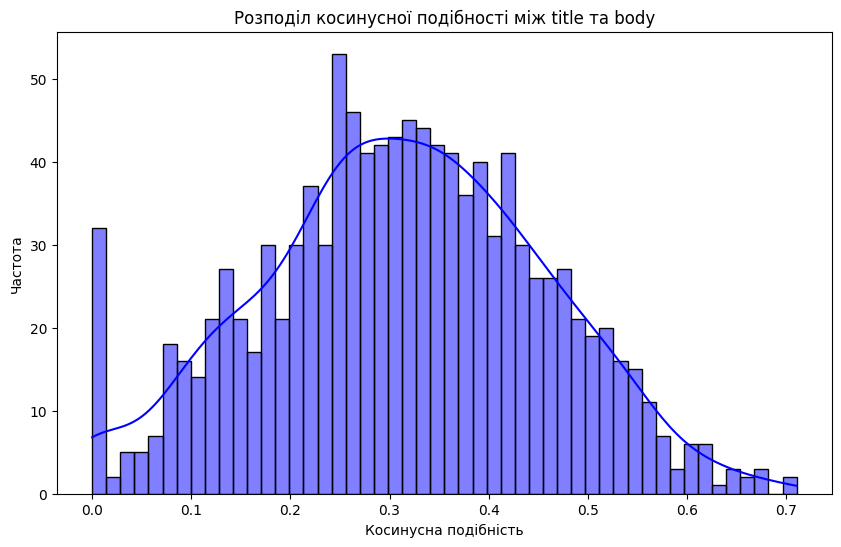

Розподіл схожих та несхожих записів:
Несхожі    1011
Схожі       111
Name: SimilarityLabel, dtype: int64


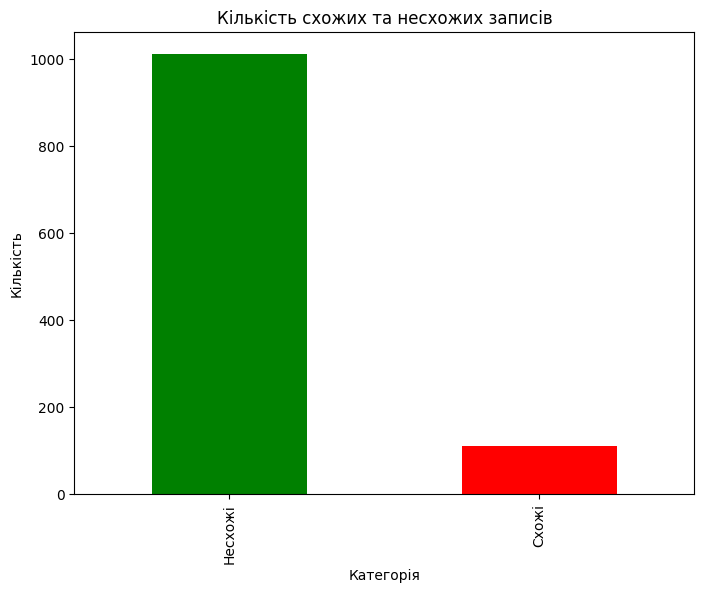

In [0]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

plt.figure(figsize=(10, 6))
sns.histplot(text_tokenized_df_pd['CosineSimilarity'], bins=50, kde=True, color='blue')
plt.title('Розподіл косинусної подібності між title та body')
plt.xlabel('Косинусна подібність')
plt.ylabel('Частота')
plt.show()


def semantic_similarity_label(score, threshold=0.5):
    return 'Схожі' if score >= threshold else 'Несхожі'

text_tokenized_df_pd['SimilarityLabel'] = text_tokenized_df_pd['CosineSimilarity'].apply(
    lambda x: semantic_similarity_label(x, threshold=0.5)
)

similarity_counts = text_tokenized_df_pd['SimilarityLabel'].value_counts()
print("Розподіл схожих та несхожих записів:")
print(similarity_counts)

plt.figure(figsize=(8, 6))
similarity_counts.plot(kind='bar', color=['green', 'red'])
plt.title('Кількість схожих та несхожих записів')
plt.xlabel('Категорія')
plt.ylabel('Кількість')
plt.show()

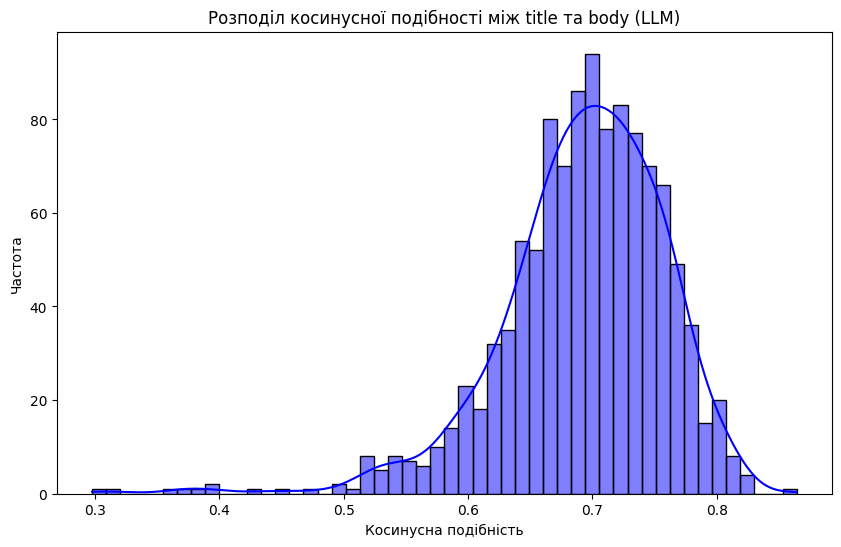

Розподіл схожих та несхожих записів:
Схожі      1110
Несхожі      12
Name: SimilarityLabel, dtype: int64


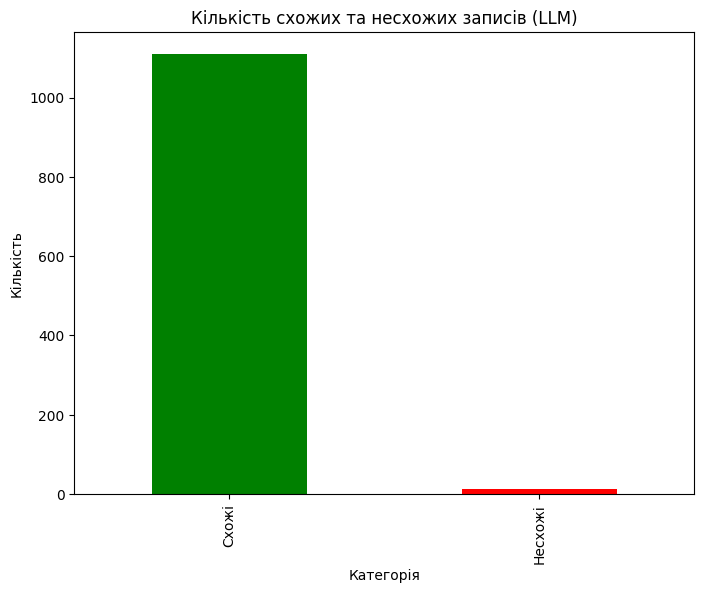

In [0]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

text_llm_cos_sim_df_pd = text_llm_cos_sim_df.select("Title", "Body", "CosineSimilarityLLM").toPandas()

plt.figure(figsize=(10, 6))
sns.histplot(text_llm_cos_sim_df_pd['CosineSimilarityLLM'], bins=50, kde=True, color='blue')
plt.title('Розподіл косинусної подібності між title та body (LLM)')
plt.xlabel('Косинусна подібність')
plt.ylabel('Частота')
plt.show()


def semantic_similarity_label(score, threshold=0.5):
    return 'Схожі' if score >= threshold else 'Несхожі'

text_llm_cos_sim_df_pd['SimilarityLabel'] = text_llm_cos_sim_df_pd['CosineSimilarityLLM'].apply(
    lambda x: semantic_similarity_label(x, threshold=0.5)
)

similarity_counts = text_llm_cos_sim_df_pd['SimilarityLabel'].value_counts()
print("Розподіл схожих та несхожих записів:")
print(similarity_counts)

plt.figure(figsize=(8, 6))
similarity_counts.plot(kind='bar', color=['green', 'red'])
plt.title('Кількість схожих та несхожих записів (LLM)')
plt.xlabel('Категорія')
plt.ylabel('Кількість')
plt.show()


## 3. Знайти кількість дублів в наборі даних: 


3.a. Порахувати вектори репрезентацій для body; ->


3.b. Порахувати кількість дублів в наборі даних з різними косинусними подібностями (наприклад > 0.7, > 0.99); 


In [0]:
cross_df = text_llm_cos_sim_df.alias("df1").join(text_llm_cos_sim_df.alias("df2"), col("df1.BodyVector") != col("df2.BodyVector"))
cross_df = cross_df.withColumn("CosineSimilarity", cosine_similarity_udf(col("df1.BodyVector"), col("df2.BodyVector")))

#cross_df.display()

In [0]:
filtered_cross_df = cross_df.filter(col("CosineSimilarity") > 0.7)
filtered_cross_df2 = cross_df.filter(col("CosineSimilarity") > 0.99)

3.c. Вивести топ-10 унікальних дата поїнтів.

In [0]:
from pyspark.sql import functions as F

uniques_df = filtered_cross_df2.select("df1.Body", "df2.Body", "CosineSimilarity") \
    .orderBy(F.col("CosineSimilarity").asc()) \
    .limit(10)

In [0]:

uniques_df.display()

---------------------------------------------------------------------------
NameError Traceback (most recent call last)
File , line 3
 1 from pyspark.sql import functions as F
----> 3 uniques_df = filtered_cross_df2.select("df1.Body", "df2.Body", "CosineSimilarity").orderBy(F.col("CosineSimilarity").asc()).limit(10)
 4 uniques_df.display()

NameError: name 'filtered_cross_df2' is not defined